In [1]:
from dataclasses import dataclass, field
from random import choice
from copy import copy
from tournament import Match, Tournament
import networkx as nx
import matplotlib.pyplot as plt

Vytvorte program na vygenerovanie rozpisu turnaja s 2n
družstvami na 2(2n − 1) hracích dní, pričom

(a) v každý hrací deň sa uskutoční n zápasov v rovnakom čase a v každom
zápase sa stretnú dve družstvá,

(b) každé družstvo hrá s každým iným počas celého trvania turnaja práve
2 zápasy, jeden na domácej a jeden na hosťovskej pôde,

(c) v prvej polovici turnaja (t.j. počas prvých 2n − 1 hracích dní) sa
každé družstvo stretne s každým iným práve raz, pričom 2 družstvá postupne
striedajú dejiská zápasov (doma/vonku) a každé zo zvyšných 2n−2 družstiev
strieda dejiská zápasov s jedinou výnimkou, kedy hrá 2 zápasy za sebou na
jednom pôsobisku (doma alebo vonku),

(d) to isté obmedzenie ako v (c) sa vzťahuje na druhú polovicu turnaja.
Vysvetlite, prečo pre n ≥ 2 v časti (c) nie je možné turnaj navrhnúť tak,
aby aspoň 3 družstvá striedali dejiská zápasov.

Algoritmus:

2x Round - robin, ale s niekoľkými úpravami:
- v prvom spustení pre párne dni prehodíme poradie zoznamov, a v druhom spustení prehodíme poradie pre nepárne dni
    - keďže párovania sú deterministické, toto nám umožní spraviť rovnaké páry, ale zmeníme ktorý tým zostáva doma a ktorý navštevuje
- pre prvých N-1 krokov platí, že musíme nájsť aktuálnu pozíciu druhého prvku z pôvodného zoznamu, a vymeniť ho z prvkom na rovnakej pozícii v druhom zozname
    - toto nám zaručí, že dodržíme podmienku o striedaní dejísk zápasov pre dva tímy (tímy 1 a 2 z pôvodného zoznamu, môžeme zvoliť aj iné tímy ale algoritmus bude komplikovanejší)
- vysvetlenie bodu d)
    - to, že každý druhý deň meníme poradie zoznamov spôsobuje, že keď zrotovaním presunieme jeden tím z prvého zoznamu do druhého, a nasledujúci deň prehodíme poradie zoznamov, tento tím bude zaručene 2x po sebe doma, alebo navštevovať, podľa toho ako pridelíme smer návštevy pre páry tímov - v tejto implementácii to je práve navštevovanie
    - toto neplatí pre všetky tímy okrem vybraných dvoch, pretože presúvanie druhého vybraného tímu medzi zoznamami to komplikuje. Všimol som si ale ďalšie vzory v pozíciach ktoré vedú k opakovaniu
        - jedným z nich je situacia, keď pre deň K platí, že prvky i a j sú v rovnakom zozname, a v dni K+1 sa po rotácii jeden z nich presunie do druhého zoznamu, a nachádzajú sa na rovnakom indexe. Pri tejto situácii zaručene jeden z nich bude navštevujúci pre deň K aj K+1

        K:       |    K+1: 

        1 5 6    |    3 2 6

        4 3 2    |    1 4 5

        1:       |    2:

        1 2 3    |    5 4 3
        
        6 5 4    |    1 6 2

    - ak by sme sa pokúsili tento problém riešiť podobnými rotáciami ako riešime smery návštev pre tím 2, eventuálne narážeme práve na zápasy s druhým prvkom, kedy rotáciu vykonať nemôžeme (lebo by sme porušili pravidlo o striedaní pre prvky 1 a 2) a zaručene dôjde k duplikácii

Round - robin:

Pre zoznam dĺžky 2N
- 2N - 1 krokov
- rozdelíme zoznam na dva zoznamy dĺžky N
- druhému zoznamu spravíme reverse (vymeníme prvý s posledným, druhý s predposledným, atď)
- vytvoríme párovania tak, že zoberieme prvý prvok z každého zoznamu, potom druhý prvok, atď
- pred ďalším krokom musíme upraviť zoznam:
    - prvok na prvej pozícii si vždy zachová pozíciu
    - ostatné prvky v každom ďalšom kroku zrotujeme po smere hodinových ručičiek o jednu pozíciu
    - z prvku N sa stane prvok 2, z prvku dva sa stane prvok 3, .. , z prvku N-1 sa stane N

In [2]:
teams = ['1', '2', '3', '4', '5', '6']
print("team count: ", len(teams))

team count:  6


In [3]:
tour = Tournament(teams)

ROUND 1
DAY 1
Creating match 1 -> 6
Creating match 5 -> 2
Creating match 3 -> 4
DAY 2
Creating match 5 -> 1
Creating match 4 -> 6
Creating match 2 -> 3
DAY 3
Creating match 1 -> 4
Creating match 5 -> 3
Creating match 6 -> 2
DAY 4
Creating match 3 -> 1
Creating match 2 -> 4
Creating match 6 -> 5
DAY 5
Creating match 1 -> 2
Creating match 3 -> 6
Creating match 4 -> 5
ROUND 2
DAY 1
Creating match 6 -> 1
Creating match 2 -> 5
Creating match 4 -> 3
DAY 2
Creating match 1 -> 5
Creating match 6 -> 4
Creating match 3 -> 2
DAY 3
Creating match 4 -> 1
Creating match 3 -> 5
Creating match 2 -> 6
DAY 4
Creating match 1 -> 3
Creating match 4 -> 2
Creating match 5 -> 6
DAY 5
Creating match 2 -> 1
Creating match 6 -> 3
Creating match 5 -> 4


In [4]:
n2 = len(teams)
expected_match_count = n2*(n2 - 1)
print("expected match count: ", expected_match_count)
matches = set(list(tour.matches.get("1").keys()) + list(tour.matches.get("2").keys()))
print("real match count: ", len(matches))

expected match count:  30
real match count:  30


In [5]:
def generate_graph(nodes: list[str], edges: list[Match], opposite_edges: list[Match] = None):
    G = nx.DiGraph()
    
    for label in nodes:
        G.add_node(label)

    for edge in edges:
        G.add_edge(edge.visiting_team, edge.homeground_team)
        
    if opposite_edges is not None:
        for edge in opposite_edges:
            G.add_edge(edge.visiting_team, edge.homeground_team)

    return G

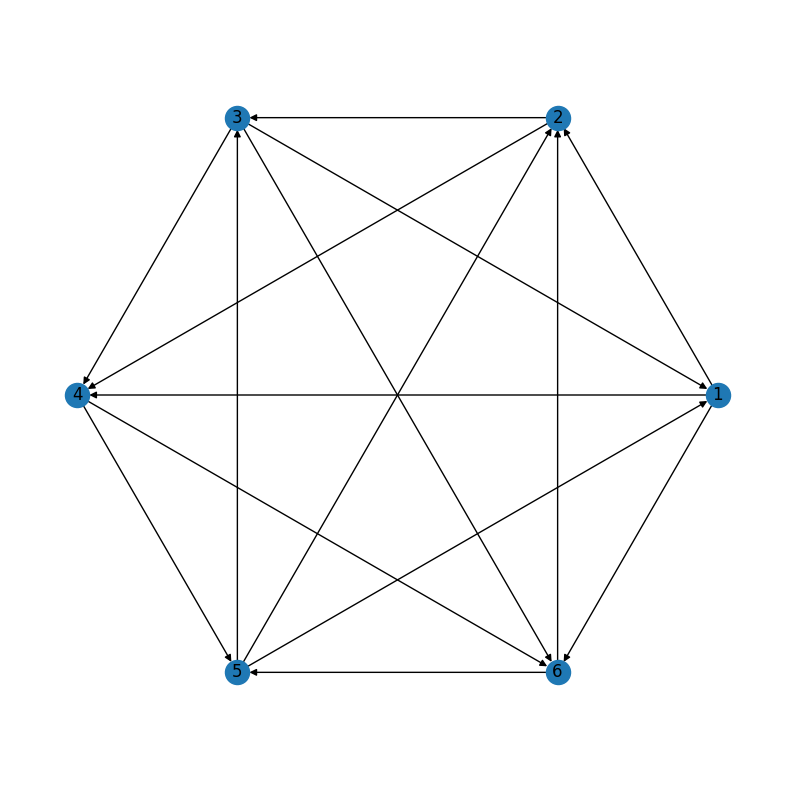

In [6]:
nodes = tour.teams
edges = list(tour.matches.get("1").values())
G = generate_graph(nodes, edges)

plt.figure(figsize=(10, 10)) 
plt.axis('equal')

pos = nx.circular_layout(G)
nx.draw(G, pos=pos, with_labels=True)

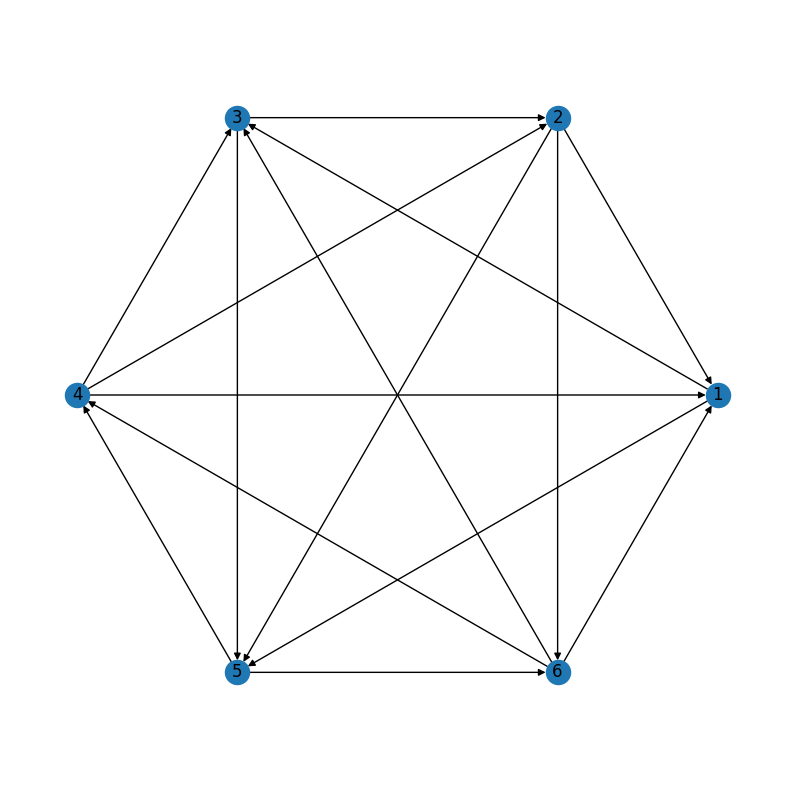

In [7]:
nodes = tour.teams
edges = list(tour.matches.get("2").values())
G = generate_graph(nodes, edges)

plt.figure(figsize=(10, 10)) 
plt.axis('equal')

pos = nx.circular_layout(G)
nx.draw(G, pos=pos, with_labels=True)

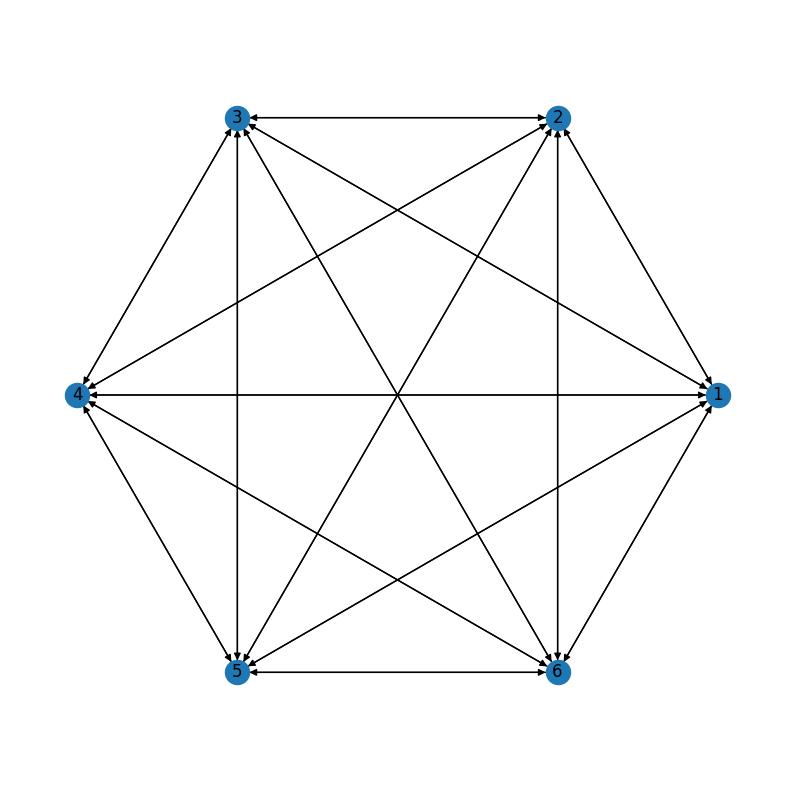

In [8]:
nodes = tour.teams
edges = list(tour.matches.get("1").values())
opposite = list(tour.matches.get("2").values())
G = generate_graph(nodes, edges, opposite)

plt.figure(figsize=(10, 10)) 
plt.axis('equal')

pos = nx.circular_layout(G)
nx.draw(G, pos=pos, with_labels=True)

In [9]:
team_half_count = 500
teams = [str(idx) for idx in range(2*team_half_count)]
print("team count: ", len(teams))

team count:  1000


In [10]:
teams = [str(idx) for idx in range(2*team_half_count)]
tour = Tournament(teams)

ROUND 1
DAY 1
Creating match 0 -> 999
Creating match 998 -> 1
Creating match 2 -> 997
Creating match 3 -> 996
Creating match 4 -> 995
Creating match 5 -> 994
Creating match 6 -> 993
Creating match 7 -> 992
Creating match 8 -> 991
Creating match 9 -> 990
Creating match 10 -> 989
Creating match 11 -> 988
Creating match 12 -> 987
Creating match 13 -> 986
Creating match 14 -> 985
Creating match 15 -> 984
Creating match 16 -> 983
Creating match 17 -> 982
Creating match 18 -> 981
Creating match 19 -> 980
Creating match 20 -> 979
Creating match 21 -> 978
Creating match 22 -> 977
Creating match 23 -> 976
Creating match 24 -> 975
Creating match 25 -> 974
Creating match 26 -> 973
Creating match 27 -> 972
Creating match 28 -> 971
Creating match 29 -> 970
Creating match 30 -> 969
Creating match 31 -> 968
Creating match 32 -> 967
Creating match 33 -> 966
Creating match 34 -> 965
Creating match 35 -> 964
Creating match 36 -> 963
Creating match 37 -> 962
Creating match 38 -> 961
Creating match 39 -> 

In [11]:
n2 = len(teams)
expected_match_count = n2*(n2 - 1)
print("expected match count: ", expected_match_count)
matches = set(list(tour.matches.get("1").keys()) + list(tour.matches.get("2").keys()))
print("real match count: ", len(matches))

expected match count:  999000
real match count:  999000


In [12]:
teams = [
    'FIRST', 'SECOND',
    'a', 'b', 'c', 'd',
    'e', 'f', 'g', 'h',
    'i', 'j', 'k', 'l',
    'm', 'n', 'o', 'p',
    'q',' r', 's', 't',
    'u', 'v', 'w', 'x',
    'y', 'z',
]
tour = Tournament(teams)

ROUND 1
DAY 1
Creating match FIRST -> z
Creating match y -> SECOND
Creating match a -> x
Creating match b -> w
Creating match c -> v
Creating match d -> u
Creating match e -> t
Creating match f -> s
Creating match g ->  r
Creating match h -> q
Creating match i -> p
Creating match j -> o
Creating match k -> n
Creating match l -> m
DAY 2
Creating match y -> FIRST
Creating match x -> z
Creating match SECOND -> w
Creating match v -> a
Creating match u -> b
Creating match t -> c
Creating match s -> d
Creating match  r -> e
Creating match q -> f
Creating match p -> g
Creating match o -> h
Creating match n -> i
Creating match m -> j
Creating match l -> k
DAY 3
Creating match FIRST -> x
Creating match y -> w
Creating match z -> v
Creating match u -> SECOND
Creating match a -> t
Creating match b -> s
Creating match c ->  r
Creating match d -> q
Creating match e -> p
Creating match f -> o
Creating match g -> n
Creating match h -> m
Creating match i -> l
Creating match j -> k
DAY 4
Creating match